# NYC Yellow Taxi Trip Analysis — January 2024

**Course Assignment 1** | Data Engineering Pipeline

This notebook implements an end-to-end pipeline covering data ingestion, cleaning, feature engineering, SQL analytics, and visualization prototyping for the NYC Yellow Taxi Trip dataset (January 2024, ~3 million rows).

In [2]:
# Core imports
import os
import requests
import pandas as pd
import polars as pl
import duckdb
import plotly.express as px
import plotly.graph_objects as go

print('All imports successful.')

All imports successful.


---
## Part 1: Data Ingestion

### 1. Programmatic Download

Both the trip parquet file and the taxi zone lookup CSV are downloaded via `requests` into `data/raw/`. The download is skipped if files already exist to avoid repeated large downloads.

In [4]:
TRIP_URL  = 'https://d37ci6vzurychx.cloudfront.net/trip-data/yellow_tripdata_2024-01.parquet'
ZONE_URL  = 'https://d37ci6vzurychx.cloudfront.net/misc/taxi_zone_lookup.csv'
RAW_DIR   = os.path.join('data', 'raw')
TRIP_PATH = os.path.join(RAW_DIR, 'yellow_tripdata_2024-01.parquet')
ZONE_PATH = os.path.join(RAW_DIR, 'taxi_zone_lookup.csv')

os.makedirs(RAW_DIR, exist_ok=True)

def download_file(url: str, dest: str) -> None:
    """Stream-download a file from url to dest, skipping if already present."""
    if os.path.exists(dest):
        print(f'  Already exists, skipping: {dest}')
        return
    print(f'  Downloading {url} ...')
    with requests.get(url, stream=True) as r:
        r.raise_for_status()
        with open(dest, 'wb') as f:
            for chunk in r.iter_content(chunk_size=1 << 20):  # 1 MB chunks
                f.write(chunk)
    print(f'  Saved to {dest}')

print('Downloading data files...')
download_file(TRIP_URL, TRIP_PATH)
download_file(ZONE_URL, ZONE_PATH)
print('Done.')

  Already exists, skipping: data\raw\yellow_tripdata_2024-01.parquet
  Already exists, skipping: data\raw\taxi_zone_lookup.csv
Done.


### 2. Data Validation

We verify: expected columns exist, date columns are proper datetimes, and we report the total row count.

In [5]:
REQUIRED_COLUMNS = [
    'tpep_pickup_datetime', 'tpep_dropoff_datetime',
    'PULocationID', 'DOLocationID', 'passenger_count',
    'trip_distance', 'fare_amount', 'tip_amount',
    'total_amount', 'payment_type',
]

def validate_data(path: str, required_cols: list) -> pl.DataFrame:
    """Load parquet, validate schema and datetime types, return DataFrame."""
    df = pl.read_parquet(path)

    # (a) Check all required columns exist
    missing = [c for c in required_cols if c not in df.columns]
    if missing:
        raise ValueError(f'Missing columns: {missing}')
    print('✓ All required columns present.')

    # (b) Verify date columns are datetime types
    for date_col in ['tpep_pickup_datetime', 'tpep_dropoff_datetime']:
        if not df[date_col].dtype in (pl.Datetime, pl.Date):
            raise TypeError(f'Column {date_col} is not a datetime type (got {df[date_col].dtype})')
    print('✓ Date columns are valid datetime types.')

    # (c) Report row count
    print(f'✓ Total rows in raw dataset: {len(df):,}')
    print(f'  Columns: {len(df.columns)}')
    print(f'  Date range: {df["tpep_pickup_datetime"].min()} → {df["tpep_pickup_datetime"].max()}')

    return df

raw_df = validate_data(TRIP_PATH, REQUIRED_COLUMNS)
zones_df = pl.read_csv(ZONE_PATH)
print(f'\n✓ Zone lookup loaded: {len(zones_df):,} zones.')

✓ All required columns present.
✓ Date columns are valid datetime types.
✓ Total rows in raw dataset: 2,964,624
  Columns: 19
  Date range: 2002-12-31 22:59:39 → 2024-02-01 00:01:15

✓ Zone lookup loaded: 265 zones.


### 3. File Organisation

Files are saved to `data/raw/`. The repository includes a `.gitignore` that excludes `data/` so no large data files are committed.

In [9]:
print('data/raw/ contents:')
for f in os.listdir(RAW_DIR):
    size_mb = os.path.getsize(os.path.join(RAW_DIR, f)) / 1e6
    print(f'  {f}  ({size_mb:.1f} MB)')

# Verify .gitignore exists and contains data/
gi_path = '.gitignore'
if os.path.exists(gi_path):
    with open(gi_path) as fh:
        content = fh.read()
    assert 'data/' in content, '.gitignore must contain data/'
    print('.gitignore correctly excludes data/')
else:
    print('.gitignore not found – please create one.')

data/raw/ contents:
  taxi_zone_lookup.csv  (0.0 MB)
  yellow_tripdata_2024-01.parquet  (50.0 MB)
.gitignore correctly excludes data/


---
## Part 2: Data Transformation & Analysis

### 4. Data Cleaning

Polars used for fast in-memory transformations:
- Drop rows with nulls in critical columns
- Remove trips with zero/negative distance, negative or >$500 fare
- Remove trips where dropoff is before pickup

In [10]:
df = raw_df.clone()
initial_rows = len(df)
print(f'Initial row count: {initial_rows:,}')

# (e) Remove nulls in critical columns
critical_cols = ['tpep_pickup_datetime', 'tpep_dropoff_datetime', 'PULocationID', 'DOLocationID', 'fare_amount']
df = df.drop_nulls(subset=critical_cols)
after_null = len(df)
print(f'After dropping nulls in critical cols: {after_null:,} (removed {initial_rows - after_null:,})')

# (f) Invalid trips
df = df.filter(
    (pl.col('trip_distance') > 0) &
    (pl.col('fare_amount') > 0) &
    (pl.col('fare_amount') <= 500)
)
after_invalid = len(df)
print(f'After removing invalid distance/fare rows: {after_invalid:,} (removed {after_null - after_invalid:,})')

# (g) Dropoff before pickup
df = df.filter(pl.col('tpep_dropoff_datetime') > pl.col('tpep_pickup_datetime'))
after_time = len(df)
print(f'After removing reversed timestamps: {after_time:,} (removed {after_invalid - after_time:,})')

# (h) Summary
total_removed = initial_rows - after_time
pct = total_removed / initial_rows * 100
print(f'\n── Cleaning Summary ──')
print(f'Rows removed: {total_removed:,} ({pct:.1f}%)')
print(f'Final clean rows: {after_time:,}')

Initial row count: 2,964,624
After dropping nulls in critical cols: 2,964,624 (removed 0)
After removing invalid distance/fare rows: 2,869,684 (removed 94,940)
After removing reversed timestamps: 2,869,572 (removed 112)

── Cleaning Summary ──
Rows removed: 95,052 (3.2%)
Final clean rows: 2,869,572


### 5. Feature Engineering

Four new columns are derived:
1. `trip_duration_minutes` — from timestamps
2. `trip_speed_mph` — distance / duration (division-by-zero safe)
3. `pickup_hour` — hour of day (0–23)
4. `pickup_day_of_week` — day name (Monday–Sunday)

In [11]:
df = df.with_columns([
    # (i) trip_duration_minutes
    ((pl.col('tpep_dropoff_datetime') - pl.col('tpep_pickup_datetime'))
     .dt.total_seconds() / 60).alias('trip_duration_minutes'),

    # (k) pickup_hour
    pl.col('tpep_pickup_datetime').dt.hour().alias('pickup_hour'),

    # (l) pickup_day_of_week
    pl.col('tpep_pickup_datetime').dt.strftime('%A').alias('pickup_day_of_week'),
])

# (j) trip_speed_mph — after duration is computed
df = df.with_columns(
    pl.when(pl.col('trip_duration_minutes') > 0)
    .then(pl.col('trip_distance') / (pl.col('trip_duration_minutes') / 60))
    .otherwise(None)
    .alias('trip_speed_mph')
)

print('New columns created:')
for col in ['trip_duration_minutes', 'trip_speed_mph', 'pickup_hour', 'pickup_day_of_week']:
    non_null = df[col].drop_nulls().len()
    print(f'  {col}: {non_null:,} non-null values')

print('\nSample stats:')
print(df.select(['trip_duration_minutes', 'trip_speed_mph', 'pickup_hour', 'pickup_day_of_week']).describe())

New columns created:
  trip_duration_minutes: 2,869,572 non-null values
  trip_speed_mph: 2,869,572 non-null values
  pickup_hour: 2,869,572 non-null values
  pickup_day_of_week: 2,869,572 non-null values

Sample stats:
shape: (9, 5)
┌────────────┬───────────────────────┬────────────────┬─────────────┬────────────────────┐
│ statistic  ┆ trip_duration_minutes ┆ trip_speed_mph ┆ pickup_hour ┆ pickup_day_of_week │
│ ---        ┆ ---                   ┆ ---            ┆ ---         ┆ ---                │
│ str        ┆ f64                   ┆ f64            ┆ f64         ┆ str                │
╞════════════╪═══════════════════════╪════════════════╪═════════════╪════════════════════╡
│ count      ┆ 2.869572e6            ┆ 2.869572e6     ┆ 2.869572e6  ┆ 2869572            │
│ null_count ┆ 0.0                   ┆ 0.0            ┆ 0.0         ┆ 0                  │
│ mean       ┆ 15.754058             ┆ 14.027495      ┆ 14.208051   ┆ null               │
│ std        ┆ 35.019202             ┆

### Join Zone Names & Convert to Pandas for DuckDB

In [12]:
# Join zone names
zones_pu = zones_df.rename({'LocationID': 'PULocationID', 'Zone': 'pickup_zone', 'Borough': 'pickup_borough'}).select(
    ['PULocationID', 'pickup_zone', 'pickup_borough']
)
zones_do = zones_df.rename({'LocationID': 'DOLocationID', 'Zone': 'dropoff_zone', 'Borough': 'dropoff_borough'}).select(
    ['DOLocationID', 'dropoff_zone', 'dropoff_borough']
)
df = df.join(zones_pu, on='PULocationID', how='left')
df = df.join(zones_do, on='DOLocationID', how='left')

# Convert to pandas for DuckDB
pdf = df.to_pandas()
print(f'Pandas DataFrame shape: {pdf.shape}')
pdf.head(3)

Pandas DataFrame shape: (2869572, 27)


,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,...,congestion_surcharge,Airport_fee,trip_duration_minutes,pickup_hour,pickup_day_of_week,trip_speed_mph,pickup_zone,pickup_borough,dropoff_zone,dropoff_borough
0,2,2024-01-01 00:57:55,2024-01-01 01:17:43,1.0,1.72,1.0,N,186,79,2,...,2.5,0.0,19.800000,0,Monday,5.212121,Penn Station/Madison Sq West,Manhattan,East Village,Manhattan
1,1,2024-01-01 00:03:00,2024-01-01 00:09:36,1.0,1.80,1.0,N,140,236,1,...,2.5,0.0,6.600000,0,Monday,16.363636,Lenox Hill East,Manhattan,Upper East Side North,Manhattan
2,1,2024-01-01 00:17:06,2024-01-01 00:35:01,1.0,4.70,1.0,N,236,79,1,...,2.5,0.0,17.916667,0,Monday,15.739535,Upper East Side North,Manhattan,East Village,Manhattan


### 6. SQL Analysis

The cleaned DataFrame is registered as a DuckDB view and queried with 5 analytical SQL statements.

In [13]:
con = duckdb.connect()
con.register('trips', pdf)
print('DuckDB view registered.')

DuckDB view registered.


#### Query 1 — Top 10 busiest pickup zones by total number of trips

In [14]:
q1 = con.execute("""
    SELECT
        pickup_zone,
        COUNT(*) AS total_trips
    FROM trips
    WHERE pickup_zone IS NOT NULL
    GROUP BY pickup_zone
    ORDER BY total_trips DESC
    LIMIT 10
""").df()
q1

,pickup_zone,total_trips
0,Midtown Center,140141
1,Upper East Side South,140118
2,JFK Airport,138427
3,Upper East Side North,133962
4,Midtown East,104342
5,Times Sq/Theatre District,102958
6,Penn Station/Madison Sq West,102152
7,Lincoln Square East,101794
8,LaGuardia Airport,87693
9,Upper West Side South,86466


#### Query 2 — Average fare amount for each hour of the day

In [15]:
q2 = con.execute("""
    SELECT
        pickup_hour,
        ROUND(AVG(fare_amount), 2) AS avg_fare
    FROM trips
    GROUP BY pickup_hour
    ORDER BY pickup_hour
""").df()
q2

,pickup_hour,avg_fare
0,0,19.68
1,1,17.74
2,2,16.63
3,3,18.54
4,4,23.45
5,5,27.50
6,6,22.03
7,7,18.75
8,8,17.83
9,9,17.95


#### Query 3 — Percentage of trips using each payment type

In [16]:
q3 = con.execute("""
    SELECT
        CASE payment_type
            WHEN 1 THEN 'Credit Card'
            WHEN 2 THEN 'Cash'
            WHEN 3 THEN 'No Charge'
            WHEN 4 THEN 'Dispute'
            WHEN 5 THEN 'Unknown'
            ELSE 'Other'
        END AS payment_label,
        COUNT(*) AS trip_count,
        ROUND(100.0 * COUNT(*) / SUM(COUNT(*)) OVER (), 2) AS pct_trips
    FROM trips
    GROUP BY payment_type
    ORDER BY trip_count DESC
""").df()
q3

,payment_label,trip_count,pct_trips
0,Credit Card,2298347,80.09
1,Cash,422713,14.73
2,Other,115195,4.01
3,Dispute,22756,0.79
4,No Charge,10561,0.37


#### Query 4 — Average tip percentage by day of week (credit card only)

In [17]:
q4 = con.execute("""
    SELECT
        pickup_day_of_week,
        ROUND(AVG(100.0 * tip_amount / NULLIF(fare_amount, 0)), 2) AS avg_tip_pct
    FROM trips
    WHERE payment_type = 1   -- credit card only
      AND fare_amount > 0
    GROUP BY pickup_day_of_week
    ORDER BY avg_tip_pct DESC
""").df()
q4

,pickup_day_of_week,avg_tip_pct
0,Thursday,29.73
1,Saturday,26.29
2,Tuesday,25.73
3,Wednesday,25.71
4,Friday,25.60
5,Monday,25.51
6,Sunday,25.10


#### Query 5 — Top 5 most common pickup-dropoff zone pairs

In [18]:
q5 = con.execute("""
    SELECT
        pickup_zone,
        dropoff_zone,
        COUNT(*) AS trip_count
    FROM trips
    WHERE pickup_zone IS NOT NULL
      AND dropoff_zone IS NOT NULL
    GROUP BY pickup_zone, dropoff_zone
    ORDER BY trip_count DESC
    LIMIT 5
""").df()
q5

,pickup_zone,dropoff_zone,trip_count
0,Upper East Side South,Upper East Side North,21641
1,Upper East Side North,Upper East Side South,19199
2,Upper East Side North,Upper East Side North,15193
3,Upper East Side South,Upper East Side South,14112
4,Midtown Center,Upper East Side South,10139


---
## Part 3: Dashboard Development

Below we prototype each of the five required visualizations that appear in `app.py`.

### Bar chart: Top 10 pickup zones by trip count

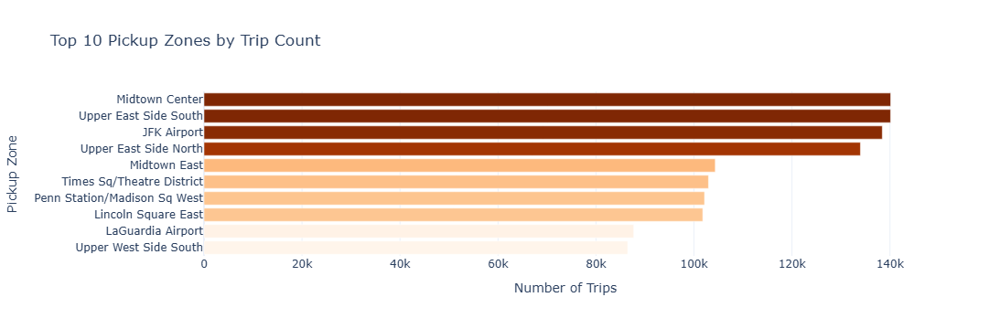

In [19]:
top_zones = q1.sort_values('total_trips')
fig1 = px.bar(
    top_zones, x='total_trips', y='pickup_zone', orientation='h',
    labels={'total_trips': 'Number of Trips', 'pickup_zone': 'Pickup Zone'},
    color='total_trips', color_continuous_scale='Oranges',
    title='Top 10 Pickup Zones by Trip Count',
    template='plotly_white',
)
fig1.update_layout(coloraxis_showscale=False)
fig1.show()

### Line chart: Average fare by hour of day (showing hourly patterns)

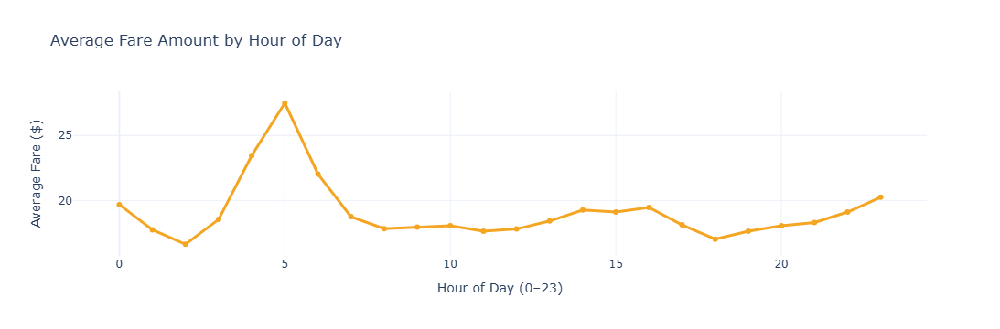

In [20]:
fig2 = px.line(
    q2, x='pickup_hour', y='avg_fare', markers=True,
    labels={'pickup_hour': 'Hour of Day (0–23)', 'avg_fare': 'Average Fare ($)'},
    title='Average Fare Amount by Hour of Day',
    template='plotly_white',
)
fig2.update_traces(line_color='#F4A522', line_width=3)
fig2.show()

### Histogram: Distribution of trip distances (with appropriate binning)

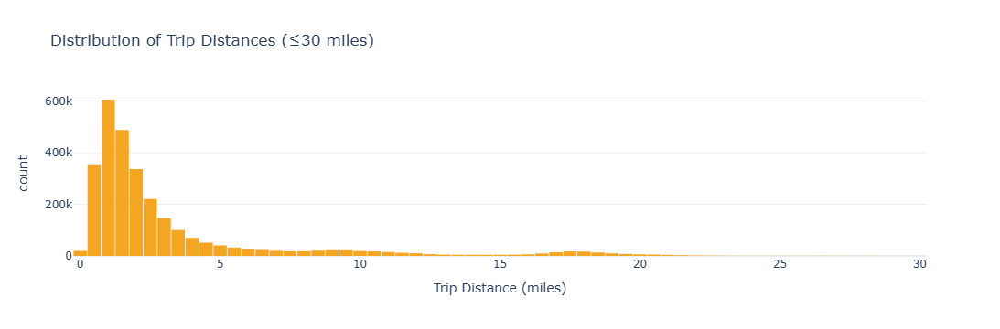

In [22]:
dist_data = pdf[pdf['trip_distance'] <= 30]['trip_distance']
fig3 = px.histogram(
    dist_data, x='trip_distance', nbins=60,
    labels={'trip_distance': 'Trip Distance (miles)'},
    color_discrete_sequence=['#F4A522'],
    title='Distribution of Trip Distances (≤30 miles)',
    template='plotly_white',
)
fig3.update_layout(bargap=0.05)
fig3.show()

### Pie or bar chart: Breakdown of payment types

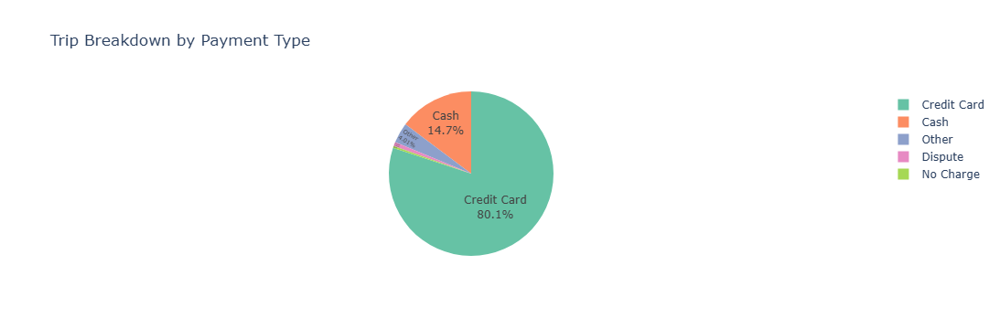

In [24]:
fig4 = px.pie(
    q3, names='payment_label', values='trip_count',
    color_discrete_sequence=px.colors.qualitative.Set2,
    title='Trip Breakdown by Payment Type',
    template='plotly_white',
)
fig4.update_traces(textposition='inside', textinfo='percent+label')
fig4.show()

### Heatmap or grouped bar chart: Trips by day of week and hour (showing weekly patterns)


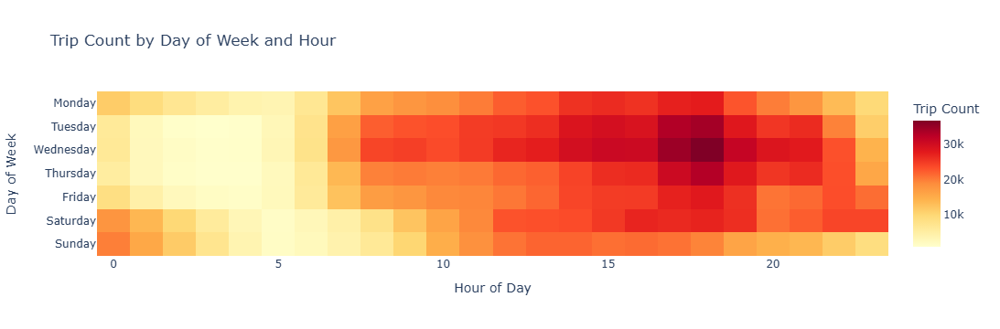

In [26]:
DAY_ORDER = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

heatmap_data = (
    pdf.groupby(['pickup_day_of_week', 'pickup_hour'])
    .size()
    .reset_index(name='trip_count')
)
heatmap_pivot = (
    heatmap_data
    .pivot(index='pickup_day_of_week', columns='pickup_hour', values='trip_count')
    .reindex([d for d in DAY_ORDER if d in heatmap_data['pickup_day_of_week'].unique()])
)

fig5 = px.imshow(
    heatmap_pivot,
    labels={'x': 'Hour of Day', 'y': 'Day of Week', 'color': 'Trip Count'},
    color_continuous_scale='YlOrRd',
    aspect='auto',
    title='Trip Count by Day of Week and Hour',
    template='plotly_white',
)
fig5.show()